<a href="https://colab.research.google.com/github/SupratikV/twitter-link-prediction/blob/main/Graph_and_Katzcentrality.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from operator import itemgetter
import itertools

In [ ]:
f=pd.read_csv('/content/twitter_combined.csv')

In [ ]:
f=f[:30000]

In [ ]:
G=nx.Graph()

In [ ]:
for index, row in f.iterrows():
 source_node= row['214328887']
 target_node = row['34428380']
 edge = (source_node, target_node)
 G.add_edges_from([edge])

In [ ]:
nx.info(G)

'Graph with 4740 nodes and 29982 edges'

In [ ]:
plt.figure(figsize=(100,100))
nx.draw(G, node_size=250, with_labels=True, pos=nx.kamada_kawai_layout(G))

CENTRALITY MEASURES:

In [ ]:
degree_cent=nx.degree_centrality(G)
sorted(degree_cent.items(), key=itemgetter(1), reverse=True)


[(40981798.0, 0.03608356193289723),
 (43003845.0, 0.0341844270943237),
 (22462180.0, 0.03334036716606879),
 (34428380.0, 0.03291833720194134),
 ('16038438', 0.028698037560666807),
 ('279787626', 0.02532179784764718),
 ('153226312', 0.02489976788351973),
 (18996905.0, 0.024477737919392277),
 (27633075.0, 0.023000633044946192),
 (31331740.0, 0.023000633044946192),
 (17868918.0, 0.022789618062882464),
 ('100581193', 0.022789618062882464),
 ('358775055', 0.022789618062882464),
 ('463952369', 0.022789618062882464),
 ('134940306', 0.022367588098755012),
 (83943787.0, 0.022156573116691284),
 (16038438.0, 0.021523528170500104),
 (8088112.0, 0.02131251318843638),
 ('461410856', 0.02110149820637265),
 (3359851.0, 0.02110149820637265),
 (28465635.0, 0.0206794682422452),
 (151338729.0, 0.0206794682422452),
 ('274153775', 0.0206794682422452),
 (117674417.0, 0.0206794682422452),
 (19493072.0, 0.02046845326018147),
 ('394263193', 0.020257438278117747),
 (116036694.0, 0.020257438278117747),
 ('2361847

In [ ]:
c_degree = list(degree_cent.values())
# Plot the centrality of the nodes
plt.figure(figsize=(16, 10))
# Degree Centrality
nx.draw(G, cmap = plt.get_cmap('spring'), node_color = c_degree, node_size=2000, pos=nx.kamada_kawai_layout(G), with_labels=True)

In [ ]:
bet = nx.betweenness_centrality(G)
sorted(bet.items(), key=itemgetter(1), reverse=True)[:15]

[(3359851.0, 0.05862635978031854),
 (15234407.0, 0.04687557705010999),
 (15439395.0, 0.045426334039229126),
 ('63485337', 0.03487202030358763),
 (10671602.0, 0.01209195889721035),
 (4620451.0, 0.011870079236270478),
 (14824849.0, 0.011809906176909593),
 ('15666380', 0.010340733126467204),
 (8295072.0, 0.00886923026044642),
 (27855118.0, 0.00873399166046529),
 ('59454817', 0.00857042700825516),
 ('35399002', 0.008470695700106591),
 ('10641722', 0.008465539846068624),
 (1268821.0, 0.008297458262635001),
 ('11726932', 0.007985166995320328)]

In [ ]:
decl = nx.closeness_centrality(G)
sorted(decl.items(), key=itemgetter(1), reverse=True)[:15]

[(15439395.0, 0.11560663940215553),
 (3359851.0, 0.11429725299512465),
 ('35399002', 0.11030236934315983),
 ('59454817', 0.11030236934315983),
 ('115395977', 0.10927462125308253),
 ('465838507', 0.10913720346981656),
 (15234407.0, 0.10879516635226041),
 ('63485337', 0.10850950762590414),
 ('79051374', 0.10756805180862437),
 ('15666380', 0.10591396655991964),
 ('193330103', 0.10486455316481168),
 ('24585498', 0.10471272224806727),
 ('20057044', 0.10446064540105698),
 ('20436922', 0.10425985607784496),
 ('24595743', 0.10415975059913363)]

In [ ]:
pgr=nx.pagerank(G)
sorted(pgr.items(), key=itemgetter(1), reverse=True)[:15]

[('3359851 1', 0.003250786529274208),
 (91221.0, 0.00275716159791623),
 ('3359851 2', 0.002103825428162338),
 (956052.0, 0.0016910634806499023),
 ('5442012 2', 0.00156790535641731),
 (921142.0, 0.0015622252788024395),
 ('73975665', 0.0015543868316285553),
 (78953.0, 0.0014917180606552143),
 (1421542.0, 0.0014764262427736528),
 (295072.0, 0.001360634781784952),
 ('11726932', 0.001342478054980398),
 (952802.0, 0.001310890651125099),
 ('16038438', 0.0013090753284647398),
 (379101.0, 0.0013053899536392233),
 (3359851.0, 0.0012837427867876908)]

COMMUNITY DETECTION


In [ ]:
from networkx.algorithms.community.centrality import girvan_newman
from networkx import edge_betweenness_centrality as betweenness

comp = girvan_newman(G)

In [ ]:
communities_generator = girvan_newman(G)
for i in range(2):
  next_comm = next(communities_generator)

for i in next_comm:
  print(i)

Kernighan Lin Bisection

In [ ]:
import networkx.algorithms.community as nx_comm
community = nx_comm.kernighan_lin_bisection(G)

In [ ]:
nodes_list = []
for com in community:
  nodes_list.append(list(com))

In [ ]:
len(nodes_list)

2

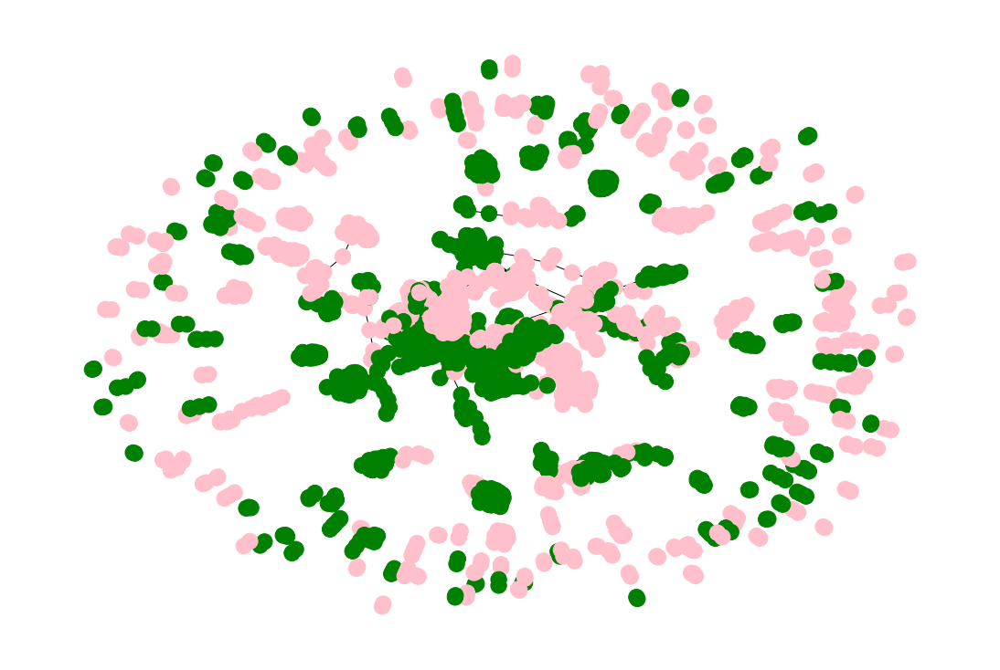

In [ ]:
plt.figure(figsize=(15,10))
color_map = []
for node in G:
  if node in nodes_list[0]:
    color_map.append('pink')
  else:
    color_map.append('green')
nx.draw(G, node_color=color_map, with_labels=False)

CLIQUE DETECTION

In [ ]:
cliques = list(nx.find_cliques(G))
[clique for clique in cliques if len(clique)>2 ]

[]

DENSITY

In [ ]:
nx.density(G)

0.0026694730768922568

BRIDGES

In [ ]:
br = nx.bridges(G)
list(nx.bridges(G))

[('6581292 3', 7699718.0),
 ('6581292 3', 7458983.0),
 ('6581292 1', 51338729.0),
 ('6581292 1', 70460311.0),
 ('6581292 1', 9493072.0),
 (43003845.0, '121533789'),
 ('220068522', 128721580.0),
 ('31414569', 81446304.0),
 ('17675120', 349413327.0),
 ('294752666', 375228586.0),
 ('8163442 2', 8019653.0),
 ('8163442 2', 26629405.0),
 ('8163442 2', 7077521.0),
 ('8163442 2', 367911.0),
 ('8163442 2', 47741328.0),
 (2367911.0, '55033682'),
 ('2367911 3', 3612973.0),
 ('2367911 3', 80580781.0),
 ('2367911 3', 5359596.0),
 ('2367911 3', 1457243.0),
 (3003845.0, '8163442 4'),
 (3003845.0, '9695312 4'),
 ('2367911 6', 9592091.0),
 ('236026868', 309782398.0),
 (367911.0, '9695312 2'),
 ('8163442 1', 7434613.0),
 ('8163442 1', 58419434.0),
 ('8163442 1', 6503181.0),
 ('8163442 1', 7675120.0),
 ('8163442 1', 52945.0),
 ('2367911 1', 8996905.0),
 ('2367911 1', 6870853.0),
 ('2367911 1', 7627996.0),
 ('2367911 1', 58419434.0),
 ('2367911 1', 86212304.0),
 ('2367911 1', 5023872.0),
 ('2367911 1', 49

TRANSIVITY

In [ ]:
Q = nx.complete_graph(1000)
print(nx.transitivity(Q))

1.0


GLOBAL CLUSTERING

In [ ]:
P = nx.complete_graph(2000)
print(nx.clustering(P,0))
print(nx.clustering(P))

1.0
{0: 1.0, 1: 1.0, 2: 1.0, 3: 1.0, 4: 1.0, 5: 1.0, 6: 1.0, 7: 1.0, 8: 1.0, 9: 1.0, 10: 1.0, 11: 1.0, 12: 1.0, 13: 1.0, 14: 1.0, 15: 1.0, 16: 1.0, 17: 1.0, 18: 1.0, 19: 1.0, 20: 1.0, 21: 1.0, 22: 1.0, 23: 1.0, 24: 1.0, 25: 1.0, 26: 1.0, 27: 1.0, 28: 1.0, 29: 1.0, 30: 1.0, 31: 1.0, 32: 1.0, 33: 1.0, 34: 1.0, 35: 1.0, 36: 1.0, 37: 1.0, 38: 1.0, 39: 1.0, 40: 1.0, 41: 1.0, 42: 1.0, 43: 1.0, 44: 1.0, 45: 1.0, 46: 1.0, 47: 1.0, 48: 1.0, 49: 1.0, 50: 1.0, 51: 1.0, 52: 1.0, 53: 1.0, 54: 1.0, 55: 1.0, 56: 1.0, 57: 1.0, 58: 1.0, 59: 1.0, 60: 1.0, 61: 1.0, 62: 1.0, 63: 1.0, 64: 1.0, 65: 1.0, 66: 1.0, 67: 1.0, 68: 1.0, 69: 1.0, 70: 1.0, 71: 1.0, 72: 1.0, 73: 1.0, 74: 1.0, 75: 1.0, 76: 1.0, 77: 1.0, 78: 1.0, 79: 1.0, 80: 1.0, 81: 1.0, 82: 1.0, 83: 1.0, 84: 1.0, 85: 1.0, 86: 1.0, 87: 1.0, 88: 1.0, 89: 1.0, 90: 1.0, 91: 1.0, 92: 1.0, 93: 1.0, 94: 1.0, 95: 1.0, 96: 1.0, 97: 1.0, 98: 1.0, 99: 1.0, 100: 1.0, 101: 1.0, 102: 1.0, 103: 1.0, 104: 1.0, 105: 1.0, 106: 1.0, 107: 1.0, 108: 1.0, 109: 1.0, 110: 

KATZ centrality

In [ ]:
katz =nx.katz_centrality(G, alpha=0.01, beta=1)
katz

{'17116707': 0.02804466219595914,
 28465635.0: 0.03973541299131278,
 '380580781': 0.027943768321969126,
 18996905.0: 0.04543099837885229,
 '221036078': 0.030816629390119275,
 153460275.0: 0.021418461778712476,
 '107830991': 0.03639660532887343,
 17868918.0: 0.044205282750331386,
 '151338729': 0.036589714789283696,
 222261763.0: 0.02942810695956158,
 '19705747': 0.01378869932329628,
 34428380.0: 0.053773635843926554,
 '222261763': 0.03658816283797109,
 88323281.0: 0.034622716014554675,
 '19933035': 0.024689389236966626,
 149538028.0: 0.03581096887217569,
 '158419434': 0.035764949216586475,
 17434613.0: 0.017436996593987595,
 '149538028': 0.03453011493823496,
 153226312.0: 0.03750229373587832,
 '364971269': 0.020396557007342497,
 '100581193': 0.04366709169957042,
 279787626.0: 0.02290868629406196,
 '113058991': 0.024724173580943986,
 69592091.0: 0.04039083255710001,
 187773078.0: 0.03433147562546204,
 '406628822': 0.03428154589338506,
 262802533.0: 0.0221701910106371,
 '460282402': 0.017

In [ ]:
a=nx.katz_centrality_numpy(G, alpha=0.1, beta=1.0, normalized=True, weight=None)
a

{'17116707': -0.042188226415533735,
 28465635.0: 0.004755361649655056,
 '380580781': 0.005883877877833158,
 18996905.0: 0.0016872269116751564,
 '221036078': -0.021591687952895445,
 153460275.0: 0.007694872887501673,
 '107830991': -0.00633112098585682,
 17868918.0: 0.0031497424015585677,
 '151338729': -0.0015903346407478555,
 222261763.0: -0.002793950269266654,
 '19705747': -0.007234737059808258,
 34428380.0: -0.027503181744029694,
 '222261763': -0.01040185607100205,
 88323281.0: -0.02377636711866558,
 '19933035': 0.0018304758039434036,
 149538028.0: 0.034050257395913795,
 '158419434': -0.0046601787476986175,
 17434613.0: 0.0037597897969740557,
 '149538028': -0.002745402735138561,
 153226312.0: 0.010192535605263366,
 '364971269': -0.016303858773758444,
 '100581193': -0.009361011524434935,
 279787626.0: -0.009321330759905006,
 '113058991': 0.004518258827195919,
 69592091.0: 0.03624299998591227,
 187773078.0: 0.031115238724954905,
 '406628822': 0.024835835001383658,
 262802533.0: 0.005381